In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage
from IPython.display import display, Image
%matplotlib inline
from PIL import Image as Image2
from PIL import ImageDraw as Image2Draw
import io

imagepath = 'sunset.jpeg'

## Exploring the ways of loading and displaying an image

### Using Matplotlib.pyplot

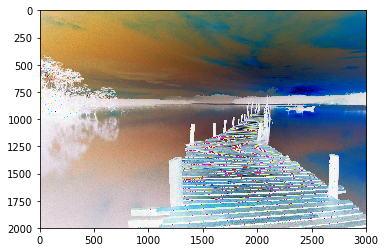

In [2]:
img1a = ndimage.imread(imagepath).astype(float)
plt.imshow(img1a)

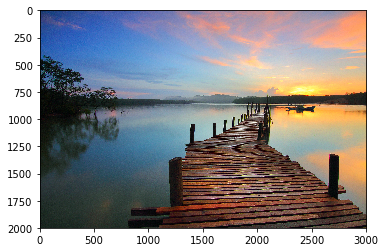

In [3]:
img1b = ndimage.imread(imagepath)
plt.imshow(img1b)

In [4]:
# Let's look at the data type differences between the two images.
print("img1a type is {} : {}".format(type(img1a), img1a.dtype))
print("img1b type is {} : {}".format(type(img1b), img1b.dtype))

img1a type is <class 'numpy.ndarray'> : float64
img1b type is <class 'numpy.ndarray'> : uint8


We see that the first way destroys the image's actual colors!

It appears uint8 gets printed properly by matplotlib.pyplot but not float64!

### Using Ipython.display

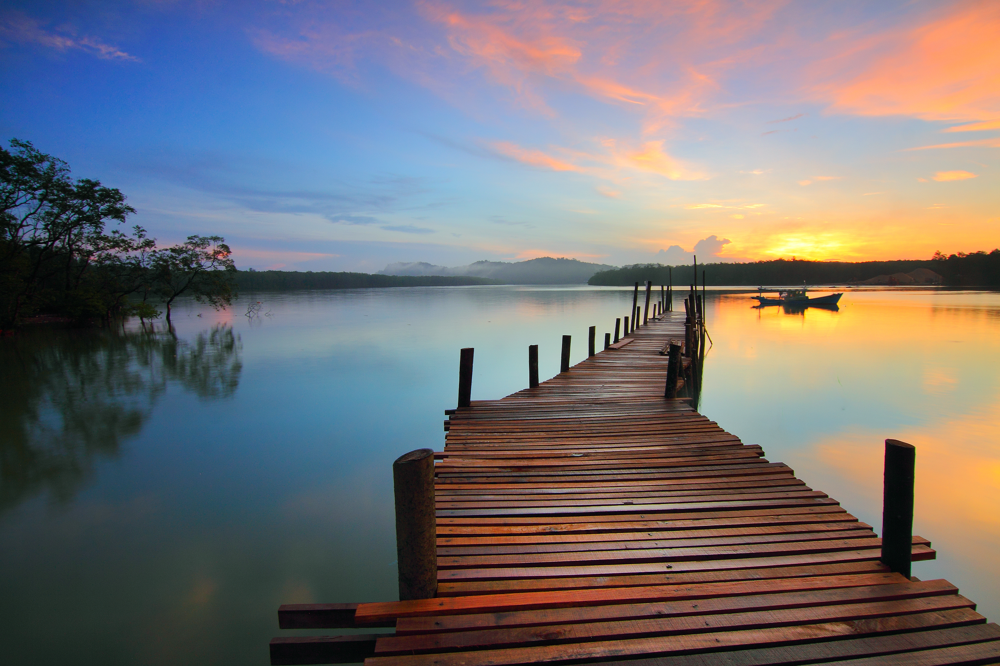

In [5]:
img2 = Image(filename=imagepath)
display(img2)

### Process an image within tensorflow

In [6]:
# Exmple code:
# https://stackoverflow.com/a/33862534/1904901
# https://gist.github.com/eerwitt/518b0c9564e500b4b50f

# Create list of files to read.
filename_queue = tf.train.string_input_producer([imagepath])

# Read an entire image file.
reader = tf.WholeFileReader()
# Read a whole file from the queue.
key, value = reader.read(filename_queue)
# Use png or jpg decoder based on your files.
var_img = tf.image.decode_jpeg(value) 


with tf.Session() as sess:
    
    tf.global_variables_initializer().run()

    # Coordinate the loading of image files.
    coord = tf.train.Coordinator()
    threads = tf.train.start_queue_runners(coord=coord)

    for i in range(1): # length of your filename list
        img3 = var_img.eval() # here is your image Tensor :) 

    # Show results
    print("img3 type is {} : {}".format(type(img3), img3.dtype))
    print("img3 shape is {}".format(img3.shape))
    
    # Evaluate tensor to get the actual decoded value.
    img3_en = tf.image.encode_jpeg(img3).eval()
    # Show results
    print("img3_en type is {}".format(type(img3_en)))
    print("img3_en length is {}".format(len(img3_en)))

    coord.request_stop()
    coord.join(threads)

img3 type is <class 'numpy.ndarray'> : uint8
img3 shape is (1999, 3000, 3)
img3_en type is <class 'bytes'>
img3_en length is 2106125


We can print the decoded image tensor and the encoded image string.

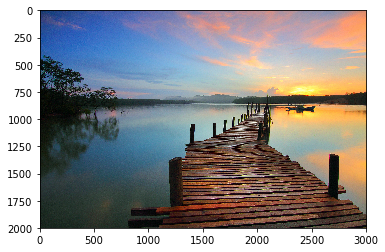

In [7]:
# Let's print encoded image tensor first
plt.imshow(img3)

The pizel size of the image is (3000, 1999)


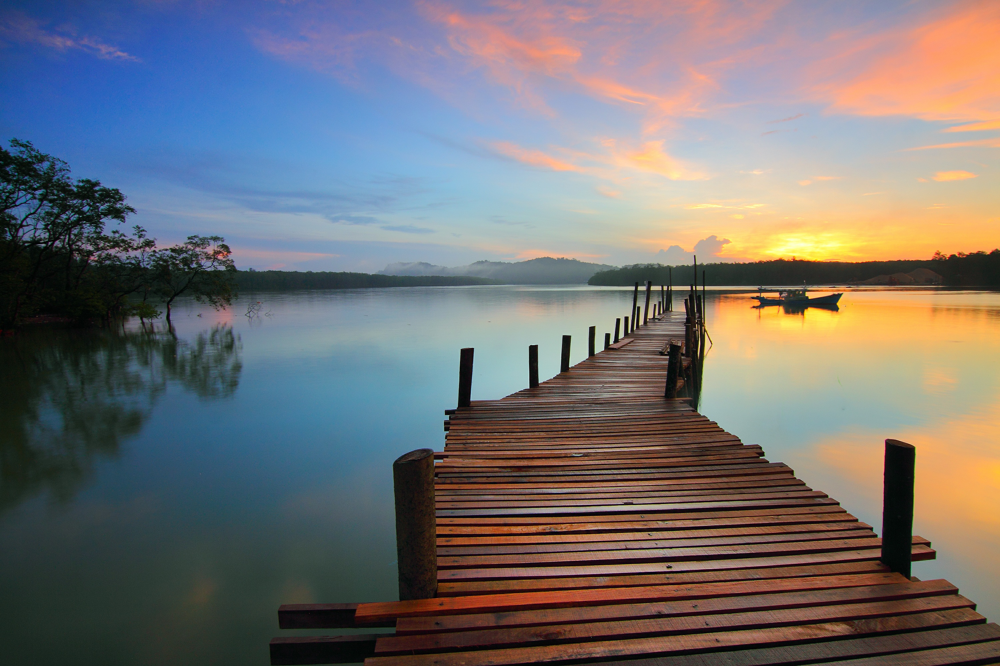

In [8]:
# Let's print encoded image string now.
# To do this we simulate the bytes object as being read from a file 
# to input it in PIL 's Image class.
stream = io.BytesIO(img3_en)
img3_en_read = Image2.open(stream)
print("The pizel size of the image is {}".format(img3_en_read.size))
draw = Image2Draw.Draw(img3_en_read)
display(img3_en_read)

## Now let's try to resize the image:

In [9]:
with tf.Session() as sess:
    
    tf.global_variables_initializer().run()
    
    img4 = tf.image.resize_images(img3, (200, 300))
    
    # Show results
    print("img4 type is {} : {}".format(type(img4), img4.dtype))
    print("img4 shape is {}".format(img4.shape))

img4 type is <class 'tensorflow.python.framework.ops.Tensor'> : <dtype: 'float32'>
img4 shape is (200, 300, 3)


We see that the resize operation has converted the numpy array to float32.
But we want it to be uint8 to print it!

img4 type is <class 'numpy.ndarray'> : uint8
img4 shape is (200, 300, 3)


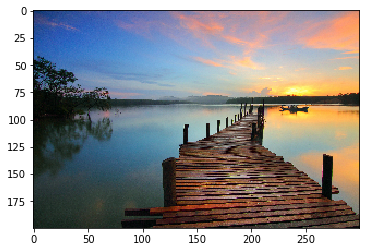

In [10]:
with tf.Session() as sess:
    
    tf.global_variables_initializer().run()
    
    # eval to convert from tensor to np.array (by getting the values).
    img4 = tf.cast(img4, np.uint8).eval()
    # Show results
    print("img4 type is {} : {}".format(type(img4), img4.dtype))
    print("img4 shape is {}".format(img4.shape))

plt.imshow(img4)